# Data Science Salaries
The following dataset is from [Kaggle](https://www.kaggle.com/datasets/arnabchaki/data-science-salaries-2023).

## Problem Definition: 
Given information of a data scientist's professional/employment information, predict that data scientist's income. 

## Define Evaluation Metrics:
I'll set one for this project. 
If during our proof of concept phase, we can reach a 95% accuracy at predicting the data scientist's income -- based on given employment information -- then we should move on with the project. 

## Define Features to Use:
In reference to the information given by [Kaggle](https://www.kaggle.com/datasets/arnabchaki/data-science-salaries-2023):


    1. work_year: The year the salary was paid.
    2. experience_level: The experience level in the job during the year
    3. employment_type: The type of employment for the role
    4. job_title: The role worked in during the year.
    5. salary: The total gross salary amount paid.
    6. salary_currency: The currency of the salary paid as an ISO 4217 currency code.
    7. salary_in_usd: The salary in USD
    8. employee_residence: Employee's primary country of residence in during the work year as an ISO 3166 country code.
    9. remote_ratio: The overall amount of work done remotely
    10. company_location: The country of the employer's main office or contracting branch
    11. company_size: The median number of people that worked for the company during the year


## Import Tools

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

# preprocess
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from scipy import stats
from scipy.stats import norm

# models
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neural_network import MLPRegressor

# evaluation
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

## Load Data

In [21]:
df = pd.read_table("data/ds_salaries.csv", delimiter=',')
df.sort_values(by="work_year", inplace=True, ascending=True)
df.head()

,work_year,experience_level,employment_type,job_title,salary,salary_currency,salary_in_usd,employee_residence,remote_ratio,company_location,company_size
3576,2020,EN,PT,ML Engineer,14000,EUR,15966,DE,100,DE,S
3681,2020,MI,FT,Data Analyst,8000,USD,8000,PK,50,PK,L
3682,2020,EN,FT,Data Engineer,4450000,JPY,41689,JP,100,JP,S
3683,2020,SE,FT,Big Data Engineer,100000,EUR,114047,PL,100,GB,S
3549,2020,EN,FT,Machine Learning Engineer,138000,USD,138000,US,100,US,S


## Exploratory Data Analysis

Exploration inspired by fellow Kaggle user with [comprehensive EDA notebook](https://www.kaggle.com/code/tumpanjawat/ds-salary-full-eda-geo-prediction#2-|-GEOSPATIAL-ANALYSIS)

### Data Types Analysis

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3755 entries, 3576 to 0
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   work_year           3755 non-null   int64 
 1   experience_level    3755 non-null   object
 2   employment_type     3755 non-null   object
 3   job_title           3755 non-null   object
 4   salary              3755 non-null   int64 
 5   salary_currency     3755 non-null   object
 6   salary_in_usd       3755 non-null   int64 
 7   employee_residence  3755 non-null   object
 8   remote_ratio        3755 non-null   int64 
 9   company_location    3755 non-null   object
 10  company_size        3755 non-null   object
dtypes: int64(4), object(7)
memory usage: 352.0+ KB


Based on the `info()` method, we can see that there are `9 features`, and `1 label`. I consider the feature at index 4 to be the equivalent of the label (which is at index 6). We have a lot of features with type `object`, which may hint that these variables are categorical variables. 

### Missing Values Analysis

In [23]:
df.isna().sum()

work_year             0
experience_level      0
employment_type       0
job_title             0
salary                0
salary_currency       0
salary_in_usd         0
employee_residence    0
remote_ratio          0
company_location      0
company_size          0
dtype: int64

### Feature Distributions

In [24]:
df['employee_residence'].value_counts()

employee_residence
US    3004
GB     167
CA      85
ES      80
IN      71
      ... 
MT       1
SK       1
LU       1
MD       1
KW       1
Name: count, Length: 78, dtype: int64

Majority of the samples come from U.S., Great Britain, Canada. The other countries that have lower number of employees residing there may not get an adequate representation of what they're income amounts to (after converting USD to their national currency). 

In [25]:
df['experience_level'].value_counts()

experience_level
SE    2516
MI     805
EN     320
EX     114
Name: count, dtype: int64

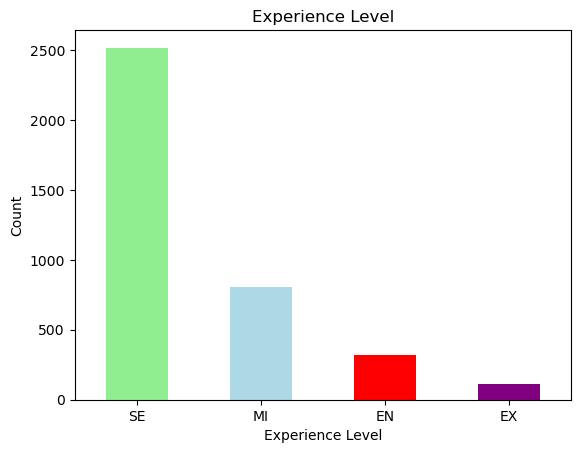

In [26]:
df['experience_level'].value_counts().plot(kind="bar", color=['lightgreen', 'lightblue', 'red', 'purple'])
plt.title("Experience Level")
plt.xlabel("Experience Level")
plt.ylabel("Count")
plt.xticks(rotation=0);

The dataset contains a great amount of senior data scientists (2500+), and less than 1000 data scientists of other career level ranges. 

In [30]:
df['employment_type'].value_counts()

employment_type
FT    3718
PT      17
CT      10
FL      10
Name: count, dtype: int64

(array([0, 1, 2, 3]),
 [Text(0, 0, 'FT'), Text(1, 0, 'PT'), Text(2, 0, 'CT'), Text(3, 0, 'FL')])

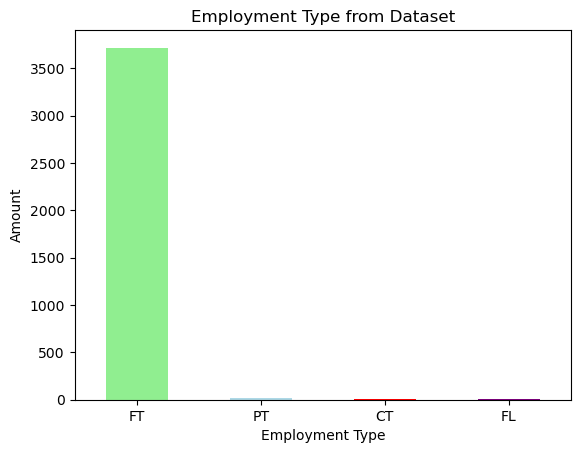

In [31]:
df['employment_type'].value_counts().plot(kind='bar', color=["lightgreen", "lightblue", "red", "purple"])
plt.title("Employment Type from Dataset")
plt.xlabel("Employment Type")
plt.ylabel("Amount")
plt.xticks(rotation=0)

This dataset contains a lot more data about full-time data scientists than that of any other employment type. The other 3 groups don't even look all that sizable in this graph.

In [32]:
df["salary_currency"].value_counts()

salary_currency
USD    3224
EUR     236
GBP     161
INR      60
CAD      25
AUD       9
SGD       6
BRL       6
PLN       5
CHF       4
HUF       3
DKK       3
JPY       3
TRY       3
THB       2
MXN       1
CLP       1
CZK       1
ILS       1
HKD       1
Name: count, dtype: int64

### Outlier Detection

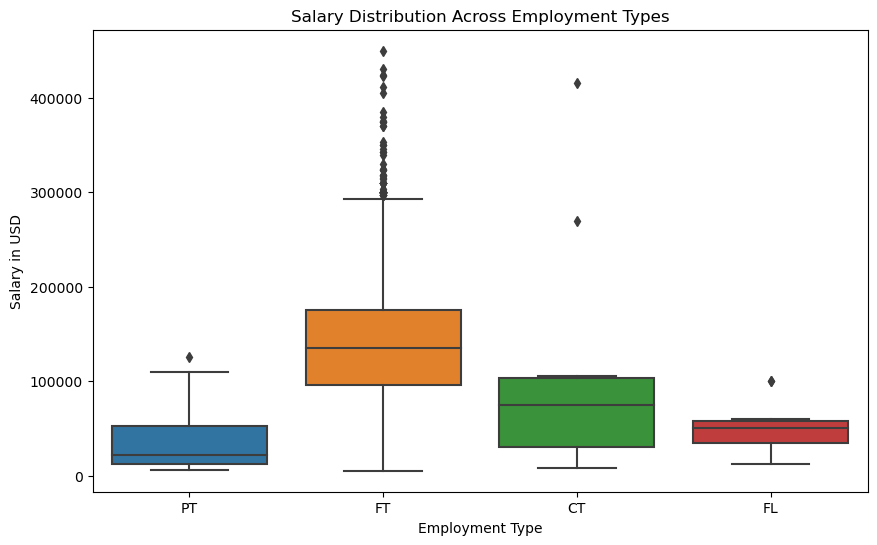

In [33]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x='employment_type', y='salary_in_usd')
plt.title('Salary Distribution Across Employment Types')
plt.xlabel("Employment Type")
plt.ylabel("Salary in USD")
plt.show()

There seems to be some outliers for all employment types. 
**Note**: We should try to adjust for these numbers during the data cleaning part, and take these outliers out in case they hinder the model performance of predicting more fair/general wages. 

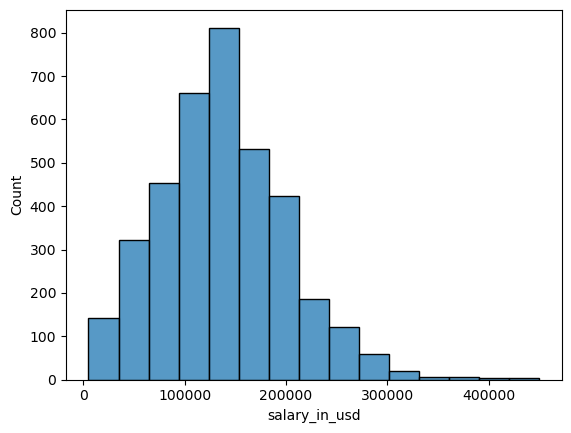

In [34]:
sns.histplot(df['salary_in_usd'], bins = 15, kde = False)
plt.show()

The histogram above show that majority of those in this dataset make somewhere between `$100K` to `$200K`yearly. This graph also indicates a right-tail skew, where there are outliers in the dataset who make over `$300k` or `$400k`. This reinforces the insight and commentary made above (with the boxplot). 

## Clean Data

In [87]:
df_tmp = df.copy()

In [88]:
# For readability

df_tmp['experience_level'] = df_tmp['experience_level'].replace({
    'SE': "Senior",
    'EN': 'Entry',
    'EX': 'Executive',
    'MI': 'Mid'
})

df_tmp['employment_type'] = df_tmp['employment_type'].replace({
    'FL': 'Freelance',
    'CT': 'Contract',
    'FT': 'Full-time',
    'PT': 'Part-time'
})

df_tmp['remote_ratio'] = df_tmp['remote_ratio'].astype(str)
df_tmp['remote_ratio'] = df_tmp['remote_ratio'].replace({
    '0': 'On-site',
    '50': 'Hybrid',
    '100': 'Remote'
})

df_tmp.head()

,work_year,experience_level,employment_type,job_title,salary,salary_currency,salary_in_usd,employee_residence,remote_ratio,company_location,company_size,job_category,adjusted_salary
3576,2020,Entry,Part-time,ML Engineer,14000,EUR,15966,DE,Remote,DE,S,Machine Learning,18324.189951
3681,2020,Mid,Full-time,Data Analyst,8000,USD,8000,PK,Hybrid,PK,L,Data Engineering,9030.161412
3682,2020,Entry,Full-time,Data Engineer,4450000,JPY,41689,JP,Remote,JP,S,Data Engineering,47846.495983
3683,2020,Senior,Full-time,Big Data Engineer,100000,EUR,114047,PL,Remote,GB,S,Other,130891.825839
3549,2020,Entry,Full-time,Machine Learning Engineer,138000,USD,138000,US,Remote,US,S,Machine Learning,155770.284357


In [89]:
# Add a new column called 'job_field' so we get an idea of each individual titles' cluster
def belong_to_job_field(job_title):
    data_engineering = ['Data Engineer', 'Data Analyst', 'Analytics Engineer',
                       'BI Data Analyst', 'Business Data Analyst', 'BI Developer',
                       'BI Analyst', 'Business Intelligence Engineer', 'BI Data Engineer',
                       'Power BI Developer']
    
    data_scientist = ['Data Scientist', 'Applied Scientist', 'Research Scientist',
                     '3D Computer Vision Researcher', 'Deep Learning Researcher',
                     'AI/Computer Vision Engineer']
    
    machine_learning = ['Machine Learning Engineer', 'ML Engineer','Lead Machine Learning Engineer',
                       'Principal Machine Learning Engineer']
    
    data_architecture = ['Data Architect', 'Big Data Architect', 'Cloud Data Architect',
                        'Principal Data Architect']
    
    management = ['Data Science Manager', 'Director of Data Science', 'Head of Data Science',
                 'Data Scientist Lead', 'Head of Machine Learning', 'Manager Data Management',
                 'Data Analytics Manager']
    
    if job_title in data_engineering:
        return "Data Engineering"
    elif job_title in data_scientist:
        return "Data Scientist"
    elif job_title in machine_learning:
        return "Machine Learning"
    elif job_title in data_architecture:
        return "Data Architecture"
    elif job_title in management:
        return "Management"
    else:
        return "Other"

In [90]:
df_tmp['job_category'] = df_tmp['job_title'].apply(belong_to_job_field)

df_tmp.head()

,work_year,experience_level,employment_type,job_title,salary,salary_currency,salary_in_usd,employee_residence,remote_ratio,company_location,company_size,job_category,adjusted_salary
3576,2020,Entry,Part-time,ML Engineer,14000,EUR,15966,DE,Remote,DE,S,Machine Learning,18324.189951
3681,2020,Mid,Full-time,Data Analyst,8000,USD,8000,PK,Hybrid,PK,L,Data Engineering,9030.161412
3682,2020,Entry,Full-time,Data Engineer,4450000,JPY,41689,JP,Remote,JP,S,Data Engineering,47846.495983
3683,2020,Senior,Full-time,Big Data Engineer,100000,EUR,114047,PL,Remote,GB,S,Other,130891.825839
3549,2020,Entry,Full-time,Machine Learning Engineer,138000,USD,138000,US,Remote,US,S,Machine Learning,155770.284357


### Back to EDA

Text(0.5, 1.0, 'Job Category Count')

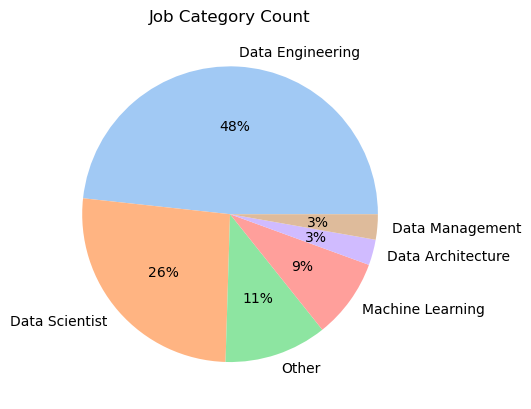

In [91]:
plt.pie(df_tmp['job_category'].value_counts(), 
        labels=["Data Engineering", "Data Scientist",
               "Other", "Machine Learning",
               "Data Architecture", "Data Management"],
       colors=sns.color_palette('pastel')[0:6],
       autopct='%0.f%%')
plt.title("Job Category Count")


#### Inflation Rates

It's important to take inflation rates into account throughout the periods indicated in this period. From a conventional economic standpoint, wages are adjusted for inflation in order to reflect what workers' purchasing power is (or what they are truly earning financially). In addition the U.S. inflation rate increased since 2020 due to the COVID pandemic. Since most of the samples in this dataset are workers who live or work for a U.S. company, this may indicate some impact on their salary. 

In [92]:
us_inflation_rates = {
    2019: 0.0181,
    2020: 0.0123,
    2021: 0.0470,
    2022: 0.065
}

global_inflation_rates = {
    2019: 0.0219,
    2020: 0.0192,
    2021: 0.0350,
    2022: 0.088
}

def adjust_salary(row):
    year = row['work_year']
    original_salary = row['salary_in_usd']
    currency = row['salary_currency']
    
    if year == 2023:
        return original_salary

    adjusted_salary = original_salary
    
    for y in range(year, 2023):
        if currency == 'USD':
            inflation_rate = us_inflation_rates[y]
        else:
            inflation_rate = global_inflation_rates[y]
            
        adjusted_salary *= (1 + inflation_rate)
    
    return adjusted_salary

In [93]:
df_tmp['adjusted_salary'] = df_tmp.apply(adjust_salary, axis=1)
df_tmp.head()

,work_year,experience_level,employment_type,job_title,salary,salary_currency,salary_in_usd,employee_residence,remote_ratio,company_location,company_size,job_category,adjusted_salary
3576,2020,Entry,Part-time,ML Engineer,14000,EUR,15966,DE,Remote,DE,S,Machine Learning,18324.189951
3681,2020,Mid,Full-time,Data Analyst,8000,USD,8000,PK,Hybrid,PK,L,Data Engineering,9030.161412
3682,2020,Entry,Full-time,Data Engineer,4450000,JPY,41689,JP,Remote,JP,S,Data Engineering,47846.495983
3683,2020,Senior,Full-time,Big Data Engineer,100000,EUR,114047,PL,Remote,GB,S,Other,130891.825839
3549,2020,Entry,Full-time,Machine Learning Engineer,138000,USD,138000,US,Remote,US,S,Machine Learning,155770.284357


### Continue Data Analysis

#### Salary Distribution
Let's re-analyze what the salary distribution is after the wages were adjusted to inflation.

col adjusted_salary : mu = 142445.66, sigma = 64692.98
col adjusted_salary: skewness = 0.5766891651013623
col adjusted_salary: kurtosis = 1.13584749981765


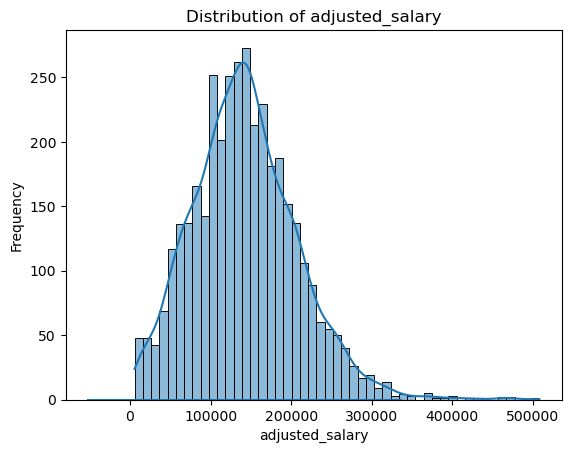

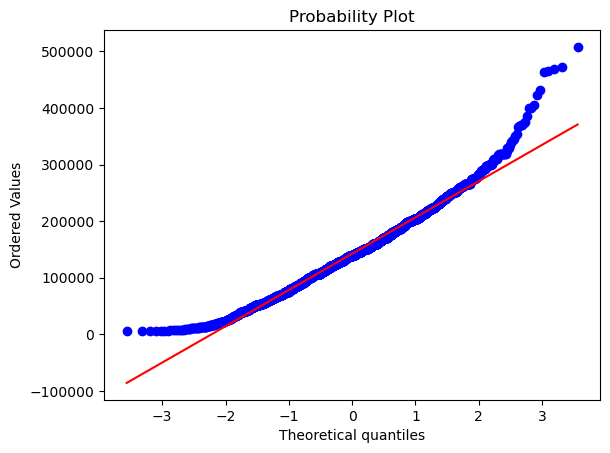

In [94]:
columns = ['adjusted_salary']

for col in columns:
    # plot the distribution to the data
    sns.histplot(df_tmp[col], kde=True)
    
    # fit the normal distribution to the data
    (mu, sigma) = stats.norm.fit(df_tmp[col])
    print(f"col {col} : mu = {mu:0.2f}, sigma = {sigma:0.2f}")

    
    # calculate the skewness and kurtosis of data
    print(f"col {col}: skewness = {df[col].skew()}")
    print(f"col {col}: kurtosis = {df[col].kurt()}")
    
    # add fitted normal distribution to the plot
    x = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)
    y = stats.norm.pdf(x, mu, sigma)
    plt.plot(x, y, label="Normal Fit")
    
    # Add labels, titles
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.title(f"Distribution of {col}")
    
    # QQ Plot
    fig = plt.figure()
    stats.probplot(df_tmp[col], plot=plt)
    
    plt.show()
    

Based on the salary distribution, there still appears to be a number of outliers where the adjusted salary amount far exceeded that average adjusted salary amount. This still indicates a right-tail skewed distribution. 

#### Boxplot  of Salary Distribution Across Employment Types

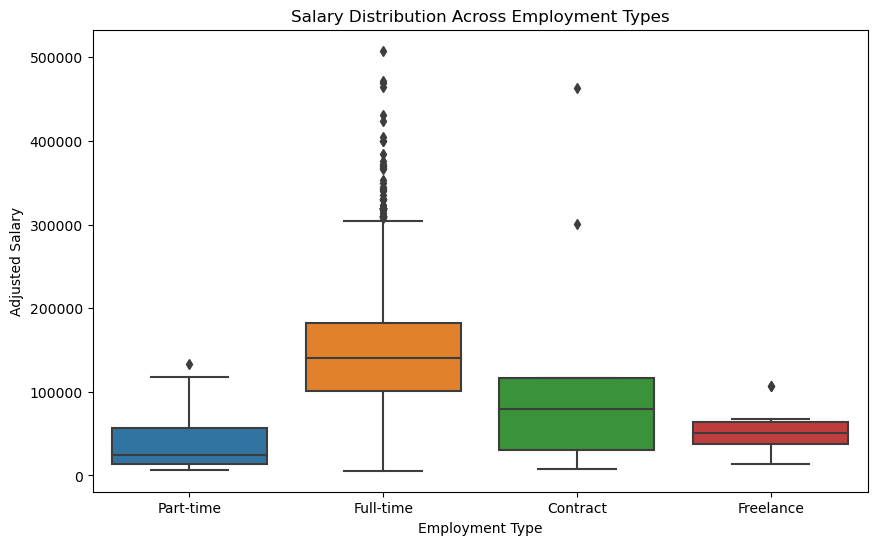

In [95]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_tmp, x='employment_type', y='adjusted_salary')
plt.title('Salary Distribution Across Employment Types')
plt.xlabel("Employment Type")
plt.ylabel("Adjusted Salary")
plt.show()

The boxplots also still showcase outliers within all employment types. 

#### Compare Salaries Between Employee Residence V. Company Location

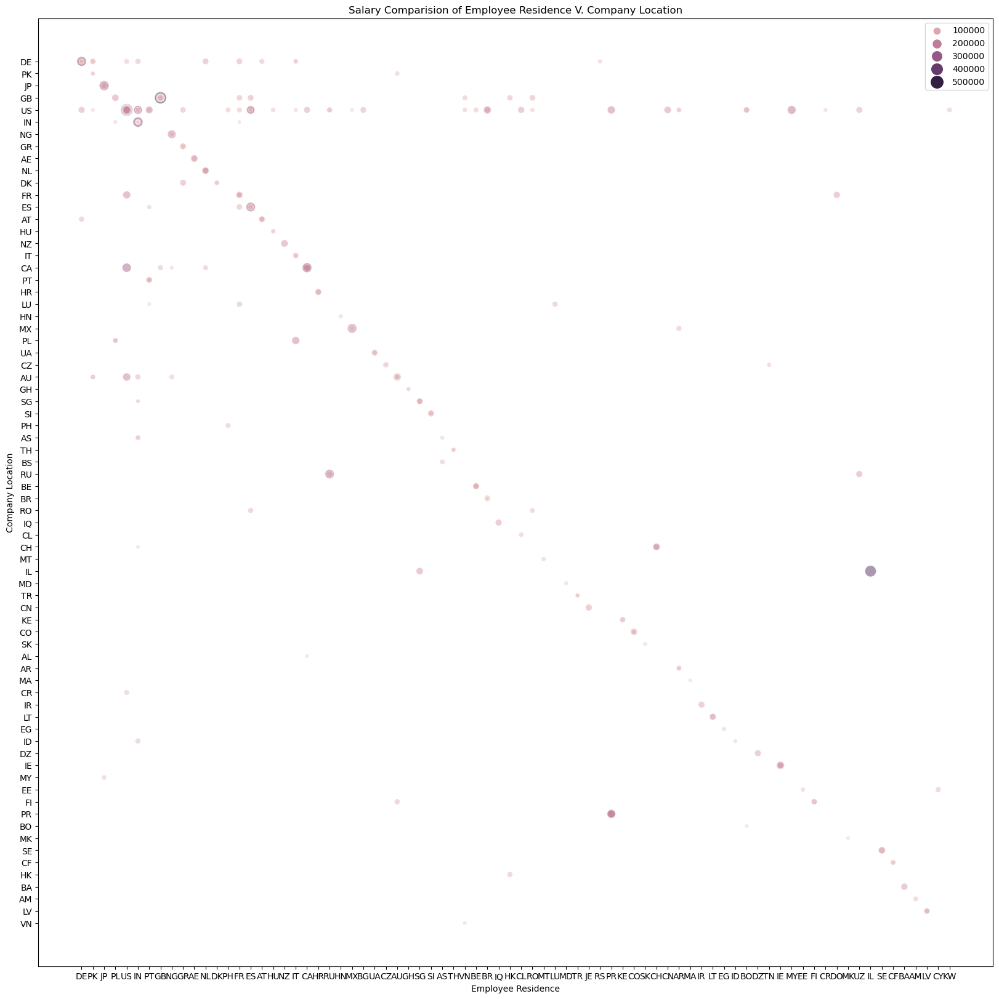

In [96]:
plt.figure(figsize=(20, 20))
sns.scatterplot(data=df_tmp, x="employee_residence", y="company_location",
               hue="adjusted_salary", size="adjusted_salary",
               sizes=(20, 200), alpha=0.5)
plt.title("Salary Comparision of Employee Residence V. Company Location")
plt.xlabel("Employee Residence")
plt.ylabel("Company Location")
plt.xticks(rotation=0)
plt.legend(loc='upper right')
plt.show()

From the graph above, we can see that majority of the samples work at the companies where this live (that is what the diagonal dotted line on the graph shows). There is also a fair number of people who reside outside of the U.S., but work for a U.S. company (as seen in that horizontal dotted line at the top of the graph). 

Similarly as what the histogram indicates, this graph above also indicates how majority of the workers make around `$100k` to `$200`. Hence, the faded-looking red circles. There are very sparse darker red circles scattered throughout the graph, which indicate workers that make over the average that's shown on the histogram. 

### Clean Out Outliers for `salary_in_usd`

In [97]:
df_tmp['salary_in_usd'].describe()

count      3755.000000
mean     137570.389880
std       63055.625278
min        5132.000000
25%       95000.000000
50%      135000.000000
75%      175000.000000
max      450000.000000
Name: salary_in_usd, dtype: float64

In [98]:
Q1 = df_tmp['salary_in_usd'].quantile(0.25)
Q3 = df_tmp['salary_in_usd'].quantile(0.75)
IQR = Q3 - Q1
IQR

80000.0

In [99]:
lower_lim = Q1 - 1.5 * IQR
upper_lim = Q3 + 1.5 * IQR
print(lower_lim)
print(upper_lim)

-25000.0
295000.0


In [100]:
outliers_15_low = (df_tmp['salary_in_usd'] < lower_lim)
outliers_15_up = (df_tmp['salary_in_usd'] > upper_lim)
len(df_tmp['salary_in_usd']) - (len(df_tmp['salary_in_usd'][outliers_15_low]) + len(df_tmp['salary_in_usd'][outliers_15_up]))

3692

The following is the number of outliers in the `salary_in_usd`. 

In [103]:
outliers_list = list(df_tmp['salary_in_usd'][(outliers_15_low | outliers_15_up)].index)

The following is the total sample size without the outliers. 

In [108]:
df_tmp.drop(index=outliers_list, inplace=True)
df_tmp.head()

,work_year,experience_level,employment_type,job_title,salary,salary_currency,salary_in_usd,employee_residence,remote_ratio,company_location,company_size,job_category,adjusted_salary
3576,2020,Entry,Part-time,ML Engineer,14000,EUR,15966,DE,Remote,DE,S,Machine Learning,18324.189951
3681,2020,Mid,Full-time,Data Analyst,8000,USD,8000,PK,Hybrid,PK,L,Data Engineering,9030.161412
3682,2020,Entry,Full-time,Data Engineer,4450000,JPY,41689,JP,Remote,JP,S,Data Engineering,47846.495983
3683,2020,Senior,Full-time,Big Data Engineer,100000,EUR,114047,PL,Remote,GB,S,Other,130891.825839
3549,2020,Entry,Full-time,Machine Learning Engineer,138000,USD,138000,US,Remote,US,S,Machine Learning,155770.284357


#### Confirm Whether There are Outliers

In [109]:
df_tmp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3692 entries, 3576 to 0
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   work_year           3692 non-null   int64  
 1   experience_level    3692 non-null   object 
 2   employment_type     3692 non-null   object 
 3   job_title           3692 non-null   object 
 4   salary              3692 non-null   int64  
 5   salary_currency     3692 non-null   object 
 6   salary_in_usd       3692 non-null   int64  
 7   employee_residence  3692 non-null   object 
 8   remote_ratio        3692 non-null   object 
 9   company_location    3692 non-null   object 
 10  company_size        3692 non-null   object 
 11  job_category        3692 non-null   object 
 12  adjusted_salary     3692 non-null   float64
dtypes: float64(1), int64(3), object(9)
memory usage: 403.8+ KB


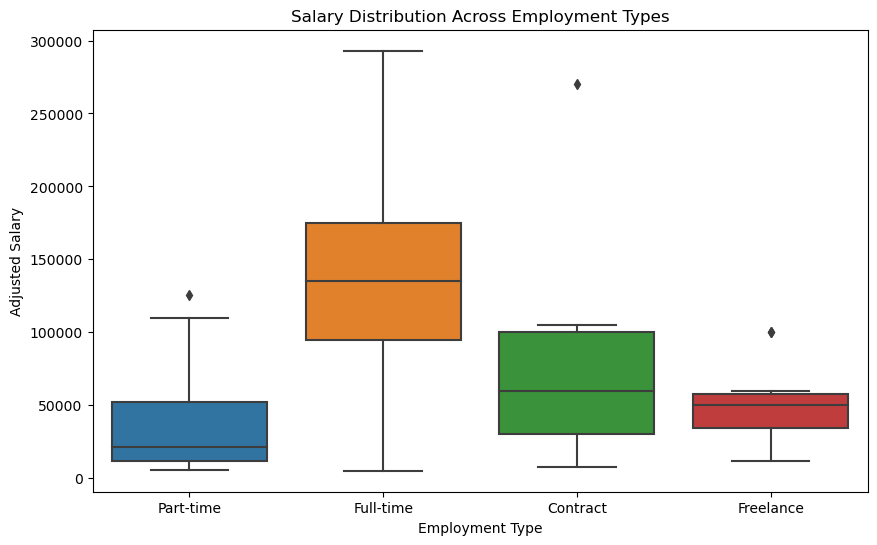

In [110]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_tmp, x='employment_type', y='salary_in_usd')
plt.title('Salary Distribution Across Employment Types')
plt.xlabel("Employment Type")
plt.ylabel("Adjusted Salary")
plt.show()

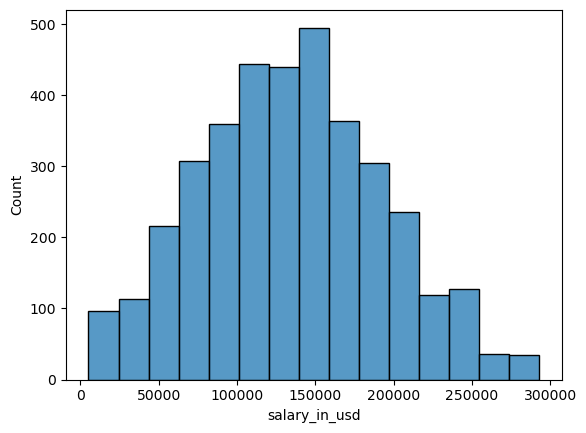

In [111]:
sns.histplot(df_tmp['salary_in_usd'], bins = 15, kde = False)
plt.show()

Looking more Gaussian!

In [112]:
df_tmp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3692 entries, 3576 to 0
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   work_year           3692 non-null   int64  
 1   experience_level    3692 non-null   object 
 2   employment_type     3692 non-null   object 
 3   job_title           3692 non-null   object 
 4   salary              3692 non-null   int64  
 5   salary_currency     3692 non-null   object 
 6   salary_in_usd       3692 non-null   int64  
 7   employee_residence  3692 non-null   object 
 8   remote_ratio        3692 non-null   object 
 9   company_location    3692 non-null   object 
 10  company_size        3692 non-null   object 
 11  job_category        3692 non-null   object 
 12  adjusted_salary     3692 non-null   float64
dtypes: float64(1), int64(3), object(9)
memory usage: 403.8+ KB


### EDA + Data Cleaning Section Takeaway:
- No null values
- A lot of categorical values 
- Overwhelming amount of U.S. workers, or people who live abroad but work for a U.S.company
- Overwhelming amount of full-time workers
- Most of these workers make around `$100K-$200K`
- There are outliers in all employment types that make well over the range specified above

## Preprocessing

- OHE: 
    - experience_level
    - employment_type
    - job_title
    - company_location
    - company_size

In [113]:
categorical_features = ["experience_level", 
                        "employment_type", 
                        "job_title",
                        "salary_currency",
                        "employee_residence",
                        "remote_ratio",
                        "company_location",
                        "company_size",
                        "job_category"
                       ]
categorical_transformer = Pipeline(steps=[
    ("onehot", OneHotEncoder(handle_unknown="ignore"))
])

preprocessor = ColumnTransformer(
    transformers=[
        ("categorical", categorical_transformer, categorical_features)
    ]
)

In [137]:
model_rf = Pipeline(steps = [
    ("preprocessor", preprocessor),
    ("model", RandomForestRegressor())
])

model_gb = Pipeline(steps = [
    ("preprocessor", preprocessor),
    ("model", GradientBoostingRegressor())
])

model_mlp = Pipeline(steps = [
    ("preprocessor", preprocessor),
    ("model", MLPRegressor())
])

rf_params = {
    "model__n_estimators": np.arange(10, 100, 10),
    "model__max_depth": [None, 3, 5, 10],
    "model__min_samples_split": np.arange(2, 20, 2),
    "model__min_samples_leaf": np.arange(1, 20, 2),
    "model__max_features": [0.5, 1, "sqrt", "auto"],
    "model__max_samples": [1000]
}

gb_params = {
    "model__n_estimators": [100, 500, 1000],
    "model__learning_rate": np.arange(0.0001, 0.1, 0.01),
    "model__max_depth": [None, 3, 5, 10],
    "model__min_samples_split": np.arange(2, 20, 2),
    "model__min_samples_leaf": np.arange(1, 20, 2),
    "model__max_features": [0.5, 1, "sqrt", "auto"]
}

mlp_params = {
    "model__activation": ['logistic', 'relu'],
    "model__solver": ["lbfgs", "sgd", "adam"],
    "model__alpha": np.arange(0.0001, 0.01, 0.001),
    "model__learning_rate": ["constant", "adaptive", "invscaling"],
    "model__early_stopping": [False, True]
}

In [138]:
rf_grid_search = GridSearchCV(estimator=model_rf,
                             param_grid=rf_params,
                             cv=5,
                             verbose=2)

gb_grid_search = GridSearchCV(estimator=model_gb,
                             param_grid=gb_params,
                             cv=5,
                             verbose=2)

mlp_grid_search = GridSearchCV(estimator=model_mlp,
                              param_grid=mlp_params,
                              cv=5,
                              verbose=2)

In [139]:
rf_random_search = RandomizedSearchCV(estimator=model_rf,
                                     param_distributions=rf_params,
                                     n_iter=10,
                                     cv=5,
                                     verbose=2)

gb_random_search = RandomizedSearchCV(estimator=model_gb,
                                     param_distributions=gb_params,
                                     n_iter=10,
                                     cv=5,
                                     verbose=2)

mlp_random_search = RandomizedSearchCV(estimator=model_mlp,
                                      param_distributions=mlp_params,
                                      n_iter=10,
                                      cv=5,
                                      verbose=2)

### Section Takeaway:
- Create a sklearn pipeline
- Turn categorical variables into numerical variables via OHE
- Remove redundant columns regarding salaries. I will only be using `salary_in_usd` as the label.

## Modeling

### Split Dataset

In [117]:
df_tmp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3692 entries, 3576 to 0
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   work_year           3692 non-null   int64  
 1   experience_level    3692 non-null   object 
 2   employment_type     3692 non-null   object 
 3   job_title           3692 non-null   object 
 4   salary              3692 non-null   int64  
 5   salary_currency     3692 non-null   object 
 6   salary_in_usd       3692 non-null   int64  
 7   employee_residence  3692 non-null   object 
 8   remote_ratio        3692 non-null   object 
 9   company_location    3692 non-null   object 
 10  company_size        3692 non-null   object 
 11  job_category        3692 non-null   object 
 12  adjusted_salary     3692 non-null   float64
dtypes: float64(1), int64(3), object(9)
memory usage: 403.8+ KB


In [118]:
df_tmp.drop(["salary", "adjusted_salary"], axis=1, inplace=True)

<class 'pandas.core.frame.DataFrame'>
Index: 3692 entries, 3576 to 0
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   work_year           3692 non-null   int64 
 1   experience_level    3692 non-null   object
 2   employment_type     3692 non-null   object
 3   job_title           3692 non-null   object
 4   salary_currency     3692 non-null   object
 5   salary_in_usd       3692 non-null   int64 
 6   employee_residence  3692 non-null   object
 7   remote_ratio        3692 non-null   object
 8   company_location    3692 non-null   object
 9   company_size        3692 non-null   object
 10  job_category        3692 non-null   object
dtypes: int64(2), object(9)
memory usage: 346.1+ KB


In [119]:
X = df_tmp.drop("salary_in_usd", axis=1)
y = df_tmp["salary_in_usd"]

In [124]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [129]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((2953, 10), (739, 10), (2953,), (739,))

### Baseline Model

In [132]:
def show_score(model):
    y_preds = model.predict(X_test)
    scores = {
        "Score": {model.score(X_train, y_train)},
        "MAE": {mean_absolute_error(y_test, y_preds)},
        "MSE": {mean_squared_error(y_test, y_preds)},
        "R_squared": {r2_score(y_test, y_preds)}
    }
    return scores

In [133]:
model_rf.fit(X_train, y_train)
show_score(model_rf)

{'Score': {0.574479307428662},
 'MAE': {33329.792563761504},
 'MSE': {1862003915.0766568},
 'R_squared': {0.4255514467975683}}

In [134]:
model_gb.fit(X_train, y_train)
show_score(model_gb)

{'Score': {0.5036123209113558},
 'MAE': {33762.005306064384},
 'MSE': {1827991454.536031},
 'R_squared': {0.43604466251543805}}

In [135]:
model_mlp.fit(X_train, y_train)
show_score(model_mlp)

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


{'Score': {-4.518270009264086},
 'MAE': {121089.68240351447},
 'MSE': {17870847069.52924},
 'R_squared': {-4.513351588828614}}

### Section Takeaway:

## Tuning/Improving

### RandomSearchCV

#### Random Forest Regressor

In [140]:
rf_random_search.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=10, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=10, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=10, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=10, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=10, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=5, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=5, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=5, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=5, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=5, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('preprocessor',
                                              ColumnTransformer(transformers=[('categorical',
                                                                               Pipeline(steps=[('onehot',
                                                                                                OneHotEncoder(handle_unknown='ignore'))]),
                                                                               ['experience_level',
                                                                                'employment_type',
                                                                                'job_title',
                                                                                'salary_currency',
                                                                                'employee_residence',
                                                                                'remote_ratio',
                                                                                'company_location',
                                                                                'company_size',
                                                                                'job_category'])])),
                                             ('model',
                                              RandomForestRegressor())]),
                   param_distributions={'model__max_depth': [None, 3, 5, 10],
                                        'model__max_features': [0.5, 1, 'sqrt',
                                                                'auto'],
                                        'model__max_samples': [1000],
                                        'model__min_samples_leaf': array([ 1,  3,  5,  7,  9, 11, 13, 15, 17, 19]),
                                        'model__min_samples_split': array([ 2,  4,  6,  8, 10, 12, 14, 16, 18]),
                                        'model__n_estimators': array([10, 20, 30, 40, 50, 60, 70, 80, 90])},
                   verbose=2)

In [141]:
rf_random_search.best_params_

{'model__n_estimators': 50,
 'model__min_samples_split': 16,
 'model__min_samples_leaf': 17,
 'model__max_samples': 1000,
 'model__max_features': 'auto',
 'model__max_depth': 10}

In [142]:
show_score(rf_random_search)

{'Score': {0.4529478108136322},
 'MAE': {34415.70898179799},
 'MSE': {1897969438.0498383},
 'R_squared': {0.4144556899788925}}

#### Gradient Boosting Regressor

In [143]:
gb_random_search.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END model__learning_rate=0.040100000000000004, model__max_depth=10, model__max_features=0.5, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=1000; total time=   4.8s
[CV] END model__learning_rate=0.040100000000000004, model__max_depth=10, model__max_features=0.5, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=1000; total time=   4.7s
[CV] END model__learning_rate=0.040100000000000004, model__max_depth=10, model__max_features=0.5, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=1000; total time=   4.5s
[CV] END model__learning_rate=0.040100000000000004, model__max_depth=10, model__max_features=0.5, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=1000; total time=   4.5s
[CV] END model__learning_rate=0.040100000000000004, model__max_depth=10, model__max_features=0.5, model__min_samples_leaf=5, model__min_samples

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.0001, model__max_depth=5, model__max_features=auto, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=500; total time=   2.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.0001, model__max_depth=5, model__max_features=auto, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=500; total time=   2.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.0001, model__max_depth=5, model__max_features=auto, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=500; total time=   2.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.0001, model__max_depth=5, model__max_features=auto, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=500; total time=   2.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.0001, model__max_depth=5, model__max_features=auto, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=500; total time=   2.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.0201, model__max_depth=10, model__max_features=auto, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=500; total time=   3.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.0201, model__max_depth=10, model__max_features=auto, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=500; total time=   4.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.0201, model__max_depth=10, model__max_features=auto, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=500; total time=   4.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.0201, model__max_depth=10, model__max_features=auto, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=500; total time=   4.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV] END model__learning_rate=0.0201, model__max_depth=10, model__max_features=auto, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=500; total time=   4.2s
[CV] END model__learning_rate=0.0201, model__max_depth=5, model__max_features=0.5, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=500; total time=   1.3s
[CV] END model__learning_rate=0.0201, model__max_depth=5, model__max_features=0.5, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=500; total time=   1.3s
[CV] END model__learning_rate=0.0201, model__max_depth=5, model__max_features=0.5, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=500; total time=   1.3s
[CV] END model__learning_rate=0.0201, model__max_depth=5, model__max_features=0.5, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=500; total time=   1.3s
[CV] END model__learning_rate=0.0201, model__max_depth=5, model__max_features=0.5, mod

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('preprocessor',
                                              ColumnTransformer(transformers=[('categorical',
                                                                               Pipeline(steps=[('onehot',
                                                                                                OneHotEncoder(handle_unknown='ignore'))]),
                                                                               ['experience_level',
                                                                                'employment_type',
                                                                                'job_title',
                                                                                'salary_currency',
                                                                                'employee_residence',
                                                                                'remote_ratio',
                                                                                'company_location',
                                                                                'company_size',
                                                                                'job_category'])])),
                                             ('model',
                                              Gr...
                   param_distributions={'model__learning_rate': array([0.0001, 0.0101, 0.0201, 0.0301, 0.0401, 0.0501, 0.0601, 0.0701,
       0.0801, 0.0901]),
                                        'model__max_depth': [None, 3, 5, 10],
                                        'model__max_features': [0.5, 1, 'sqrt',
                                                                'auto'],
                                        'model__min_samples_leaf': array([ 1,  3,  5,  7,  9, 11, 13, 15, 17, 19]),
                                        'model__min_samples_split': array([ 2,  4,  6,  8, 10, 12, 14, 16, 18]),
                                        'model__n_estimators': [100, 500,
                                                                1000]},
                   verbose=2)

In [144]:
gb_random_search.best_params_

{'model__n_estimators': 500,
 'model__min_samples_split': 2,
 'model__min_samples_leaf': 3,
 'model__max_features': 0.5,
 'model__max_depth': 5,
 'model__learning_rate': 0.0201}

In [145]:
gb_random_search.score(X_test, y_test)

0.4518050582558455

#### MLPRegressor

In [146]:
mlp_random_search.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   3.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   3.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   3.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   3.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   3.6s
[CV] END model__activation=logistic, model__alpha=0.0091, model__early_stopping=True, model__learning_rate=invscaling, model__solver=lbfgs; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=logistic, model__alpha=0.0091, model__early_stopping=True, model__learning_rate=invscaling, model__solver=lbfgs; total time=  12.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=logistic, model__alpha=0.0091, model__early_stopping=True, model__learning_rate=invscaling, model__solver=lbfgs; total time=   7.4s
[CV] END model__activation=logistic, model__alpha=0.0091, model__early_stopping=True, model__learning_rate=invscaling, model__solver=lbfgs; total time=   2.6s
[CV] END model__activation=logistic, model__alpha=0.0091, model__early_stopping=True, model__learning_rate=invscaling, model__solver=lbfgs; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0071, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   3.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0071, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   3.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0071, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   3.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0071, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   3.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0071, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   3.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   2.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   2.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   1.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   2.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   1.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=invscaling, model__solver=sgd; total time=   2.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=invscaling, model__solver=sgd; total time=   3.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=invscaling, model__solver=sgd; total time=   3.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=invscaling, model__solver=sgd; total time=   2.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=invscaling, model__solver=sgd; total time=   2.9s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   0.2s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   0.2s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   0.2s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   2.8s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=adaptive, model__solver=lbfgs; total time=   2.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=adaptive, model__solver=lbfgs; total time=   2.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=adaptive, model__solver=lbfgs; total time=   2.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=adaptive, model__solver=lbfgs; total time=   2.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=relu, model__alpha=0.0081, model__early_stopping=False, model__learning_rate=adaptive, model__solver=lbfgs; total time=   2.0s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   0.2s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   0.2s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   0.2s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   0.2s
[CV] END model__activation=logistic, model__alpha=0.0021, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=logistic, model__alpha=0.0051, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   7.0s
[CV] END model__activation=logistic, model__alpha=0.0051, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=logistic, model__alpha=0.0051, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   6.7s
[CV] END model__activation=logistic, model__alpha=0.0051, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   8.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


[CV] END model__activation=logistic, model__alpha=0.0051, model__early_stopping=True, model__learning_rate=constant, model__solver=lbfgs; total time=   9.4s
[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.1s
[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.6s
[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.8s
[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.7s
[CV] END model__activation=relu, model__alpha=0.0011, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('preprocessor',
                                              ColumnTransformer(transformers=[('categorical',
                                                                               Pipeline(steps=[('onehot',
                                                                                                OneHotEncoder(handle_unknown='ignore'))]),
                                                                               ['experience_level',
                                                                                'employment_type',
                                                                                'job_title',
                                                                                'salary_currency',
                                                                                'employee_residence',
                                                                                'remote_ratio',
                                                                                'company_location',
                                                                                'company_size',
                                                                                'job_category'])])),
                                             ('model', MLPRegressor())]),
                   param_distributions={'model__activation': ['logistic',
                                                              'relu'],
                                        'model__alpha': array([0.0001, 0.0011, 0.0021, 0.0031, 0.0041, 0.0051, 0.0061, 0.0071,
       0.0081, 0.0091]),
                                        'model__early_stopping': [False, True],
                                        'model__learning_rate': ['constant',
                                                                 'adaptive',
                                                                 'invscaling'],
                                        'model__solver': ['lbfgs', 'sgd',
                                                          'adam']},
                   verbose=2)

In [147]:
mlp_random_search.best_params_

{'model__solver': 'lbfgs',
 'model__learning_rate': 'adaptive',
 'model__early_stopping': False,
 'model__alpha': 0.0081,
 'model__activation': 'relu'}

In [148]:
mlp_random_search.score(X_test, y_test)

0.4029651215465986

With RandomizedSearchCV, seems like the picked params did less well than the baseline models for both RandomForestRegressor, GradientBoostingRegressor. However, MLPRegressor has improved drastically from its baseline model. 

### GridSearchCV

#### Random Forest Regressor

In [149]:
rf_grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 12960 candidates, totalling 64800 fits
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sampl

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_sa

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=0.5, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9,

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, mod

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_le

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_sample

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   1.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   1.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   1.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   0.9s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__m

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__mi

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_s

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mode

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=sqrt, model__max_samples=1000, mo

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   1.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   1.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   1.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   1.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   1.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   1.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   1.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   1.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   1.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   1.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   1.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   1.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   1.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   1.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   1.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   1.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   1.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   1.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   1.3s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   1.2s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   1.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   1.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   0.9s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   1.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.9s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   1.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   1.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.8s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.9s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.8s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.8s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.7s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.7s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.7s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.7s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.7s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.7s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.7s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.7s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.7s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.6s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.5s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.4s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=None, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__mi

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, mode

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, mod

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19

[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_sp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_s

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samp

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, mo

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=7

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, mod

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=9

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_l

[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, mod

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, mod

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_l

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_l

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_l

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.3s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=1

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as i

[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=80; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\ensemble\_forest.py:413: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


[CV] END model__max_depth=3, model__max_features=auto, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model_

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=1, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=5, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=7, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__mi

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=9, mode

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=11

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15,

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=15

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=60; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=17

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=80; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, mod

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19

[CV] END model__max_depth=5, model__max_features=0.5, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=90; total time=   0.2s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sample

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=1, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=3, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=5, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=10, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=16, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_samples_split=18, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=7, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=2, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=6, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_sp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=12, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=16, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=9, model__min_sampl

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=2, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=6, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=8, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_sam

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=12, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=14, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=16, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min_samples_split=18, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=11, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=2, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=6, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=16, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min_samples_split=18, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=13, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=2, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=4, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=6, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=15, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=16, model__n_estimators=90; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=17, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_sa

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=4, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=6, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=8, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samp

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=12, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=16, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min_samples_split=18, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=1, model__max_samples=1000, model__min_samples_leaf=19, model__min

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=2, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=4, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=6, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=8, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=10, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=12, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=14, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=16, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=1, model__min_samples_split=18, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, 

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=2, model__n_estimators=90; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=4, model__n_estimators=10; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=6, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=20; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=8, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=10, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=30; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=12, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=14, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=40; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=16, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3, model__min_samples_split=18, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=3

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=2, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=50; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=4, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=60; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=6, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=8, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, mod

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=10, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5

[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=70; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.1s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5, model__min_samples_split=12, model__n_estimators=80; total time=   0.0s
[CV] END model__max_depth=5, model__max_features=sqrt, model__max_samples=1000, model__min_samples_leaf=5

KeyboardInterrupt: 

In [58]:
rf_grid_search.best_params_

{'model__max_depth': None,
 'model__min_samples_split': 4,
 'model__n_estimators': 500}

In [59]:
rf_grid_search.score(X_test, y_test)

0.36855493960558594

#### Gradient Boosting Regressor

In [63]:
gb_grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 24 candidates, totalling 120 fits


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   4.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   4.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  19.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  17.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  15.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  17.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  16.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  33.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  37.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  34.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  39.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  38.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   3.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   4.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   5.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   6.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   4.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.01, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   5.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   4.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   4.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   4.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  17.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  19.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  16.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  17.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  15.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  30.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  35.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  37.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  38.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV] END model__learning_rate=0.05, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  41.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   4.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   3.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   4.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   5.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.05, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   3.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   2.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  15.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  15.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  16.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  17.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  17.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  30.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  29.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  30.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  31.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  37.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   1.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   1.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   3.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   3.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   3.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   6.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   3.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   4.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   5.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.1, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   4.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   4.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=100; total time=   3.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  13.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  14.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  14.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  14.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=500; total time=  14.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  27.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  31.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  27.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  32.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=None, model__max_features=auto, model__n_estimators=1000; total time=  35.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=100; total time=   0.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   3.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   2.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=500; total time=   3.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   6.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   5.4s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   5.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   5.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

[CV] END model__learning_rate=0.5, model__max_depth=5, model__max_features=auto, model__n_estimators=1000; total time=   4.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\tree\_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitl

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('categorical',
                                                                         Pipeline(steps=[('onehot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['experience_level',
                                                                          'employment_type',
                                                                          'job_title',
                                                                          'employee_residence',
                                                                          'remote_ratio',
                                                                          'company_size',
                                                                          'job_category'])])),
                                       ('model', GradientBoostingRegressor())]),
             param_grid={'model__learning_rate': [0.01, 0.05, 0.1, 0.5],
                         'model__max_depth': [None, 5],
                         'model__max_features': ['auto'],
                         'model__n_estimators': [100, 500, 1000]},
             verbose=2)

In [64]:
gb_grid_search.best_params_

{'model__learning_rate': 0.05,
 'model__max_depth': 5,
 'model__max_features': 'auto',
 'model__n_estimators': 500}

In [65]:
gb_grid_search.score(X_test, y_test)

0.3894317519314874

#### MLP Regressor

In [66]:
mlp_grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   0.3s
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   1.2s
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   0.3s
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   0.3s
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   1.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   4.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   5.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   7.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   6.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   7.5s
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   2.3s
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   1.6s
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   1.2s
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   2.4s
[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   2.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   6.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   4.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   4.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   6.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   4.5s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   1.5s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.9s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   1.3s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.5s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   2.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   5.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   3.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   3.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   4.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   4.2s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   1.5s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   1.6s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   1.6s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   1.8s
[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   2.6s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   4.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   3.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   3.5s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   4.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.0001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   4.7s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   0.1s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   1.0s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   0.3s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   0.1s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=sgd; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   3.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   6.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   6.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   4.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=constant, model__solver=adam; total time=   5.3s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   2.1s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   2.6s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   2.6s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   1.7s
[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=sgd; total time=   2.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   6.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   6.8s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   7.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=  10.0s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=False, model__learning_rate=adaptive, model__solver=adam; total time=   7.2s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   1.4s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   2.9s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.8s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.9s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=sgd; total time=   0.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   3.7s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   5.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   5.1s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   3.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=constant, model__solver=adam; total time=   4.7s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   2.8s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   3.8s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   1.5s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   2.3s
[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=sgd; total time=   2.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   6.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   5.2s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   3.9s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   6.3s


C:\Users\katie\anaconda3\envs\ml_basics\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[CV] END model__alpha=0.001, model__early_stopping=True, model__learning_rate=adaptive, model__solver=adam; total time=   4.9s


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('categorical',
                                                                         Pipeline(steps=[('onehot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['experience_level',
                                                                          'employment_type',
                                                                          'job_title',
                                                                          'employee_residence',
                                                                          'remote_ratio',
                                                                          'company_size',
                                                                          'job_category'])])),
                                       ('model', MLPRegressor())]),
             param_grid={'model__alpha': [0.0001, 0.001],
                         'model__early_stopping': [False, True],
                         'model__learning_rate': ['constant', 'adaptive'],
                         'model__solver': ['sgd', 'adam']},
             verbose=2)

In [67]:
mlp_grid_search.best_params_

{'model__alpha': 0.001,
 'model__early_stopping': True,
 'model__learning_rate': 'adaptive',
 'model__solver': 'sgd'}

In [68]:
mlp_grid_search.score(X_test, y_test)

-0.004031086217900937

## Evaluate Models

#### Compare Metrics

In [70]:
def evaluate_metrics(y_true, y_preds):
    """
        Perform evaluation comparison on actual labels VS. predicted labels
    """
    r2 = r2_score(y_true, y_preds)
    mae = mean_absolute_error(y_true, y_preds)
    mse = mean_squared_error(y_true, y_preds)
    
    metric_dict = {
        "r_squared": round(r2, 2),
        "mae": round(mae, 2),
        "mse": round(mse, 2)
    }
    
    print(f"R squared: {r2*100:0.2f}")
    print(f"Mean Squared Error (MSE): {mse:0.2f}")
    print(f"Mean Absolute Error (MSE): {mae:0.2f}")
    
    return metric_dict

#### Baseline Metrics

In [90]:
rf_baseline_y_preds = model_rf.predict(X_test)
rf_baseline_metrics = evaluate_metrics(y_test, rf_baseline_y_preds)

R squared: 37.16
Mean Squared Error (MSE): 2754659073.75
Mean Absolute Error (MSE): 37200.70


In [100]:
gb_baseline_y_preds = model_gb.predict(X_test)
gb_baseline_metrics = evaluate_metrics(y_test, gb_baseline_y_preds)

R squared: 36.99
Mean Squared Error (MSE): 2762113602.72
Mean Absolute Error (MSE): 37750.05


In [102]:
mlp_baseline_y_preds = model_mlp.predict(X_test)
mlp_baseline_metrics = evaluate_metrics(y_test, mlp_baseline_y_preds)

R squared: -387.49
Mean Squared Error (MSE): 21369787017.47
Mean Absolute Error (MSE): 130428.43


#### RandomSearchCV Metrics

In [91]:
rf_random_y_preds = model_rf.predict(X_test)
rf_random_metrics = evaluate_metrics(y_test, rf_random_y_preds)

R squared: 37.16
Mean Squared Error (MSE): 2754659073.75
Mean Absolute Error (MSE): 37200.70


In [92]:
gb_random_y_preds = model_gb.predict(X_test)
gb_random_metrics = evaluate_metrics(y_test, gb_random_y_preds)

R squared: 36.99
Mean Squared Error (MSE): 2762113602.72
Mean Absolute Error (MSE): 37750.05


In [93]:
mlp_random_y_preds = model_mlp.predict(X_test)
mlp_random_metrics = evaluate_metrics(y_test, mlp_random_y_preds)

R squared: -387.49
Mean Squared Error (MSE): 21369787017.47
Mean Absolute Error (MSE): 130428.43


#### GridSearchCV Metrics

In [94]:
rf_y_preds = model_rf.predict(X_test)
rf_metrics = evaluate_metrics(y_test, rf_y_preds)

R squared: 37.16
Mean Squared Error (MSE): 2754659073.75
Mean Absolute Error (MSE): 37200.70


In [95]:
gb_y_preds = model_gb.predict(X_test)
gb_metrics = evaluate_metrics(y_test, gb_y_preds)

R squared: 36.99
Mean Squared Error (MSE): 2762113602.72
Mean Absolute Error (MSE): 37750.05


In [96]:
mlp_y_preds = model_mlp.predict(X_test)
mlp_metrics = evaluate_metrics(y_test, mlp_y_preds)

R squared: -387.49
Mean Squared Error (MSE): 21369787017.47
Mean Absolute Error (MSE): 130428.43


#### Plot

<Axes: >

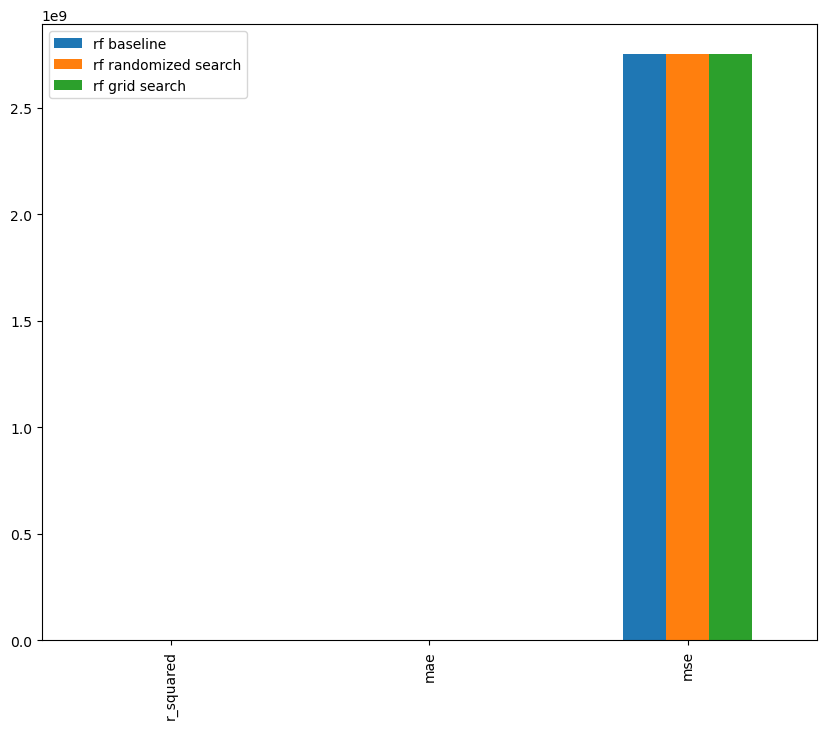

In [103]:
rf_compare_metrics = pd.DataFrame({
    "rf baseline": rf_baseline_metrics,
    "rf randomized search": rf_random_metrics,
    "rf grid search": rf_metrics,
})

rf_compare_metrics.plot.bar(figsize=(10, 8))

<Axes: >

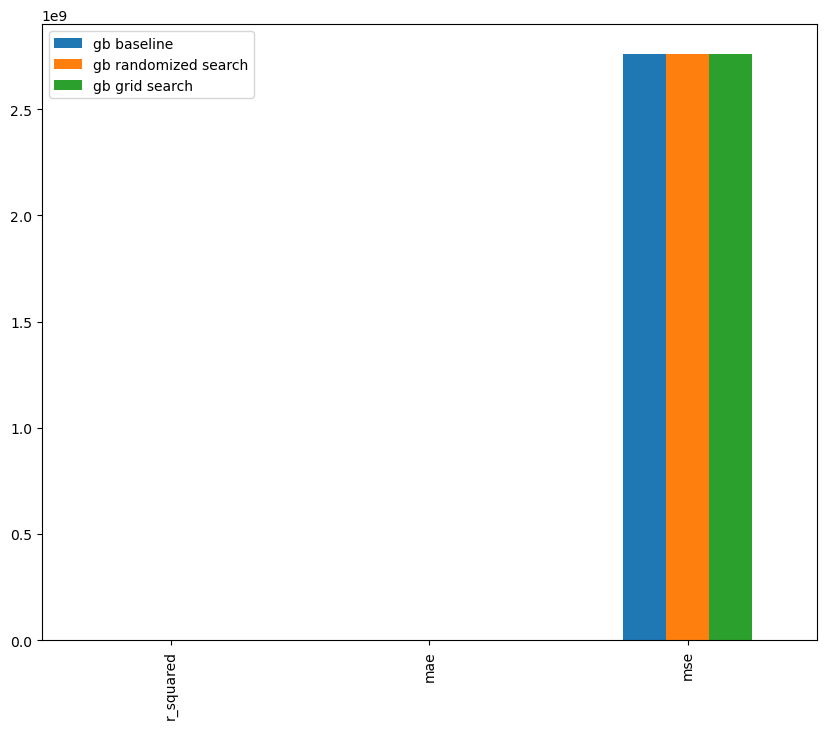

In [104]:
gb_compare_metrics = pd.DataFrame({
    "gb baseline": gb_baseline_metrics,
    "gb randomized search": gb_random_metrics,
    "gb grid search": gb_metrics,
})

gb_compare_metrics.plot.bar(figsize=(10, 8))

<Axes: >

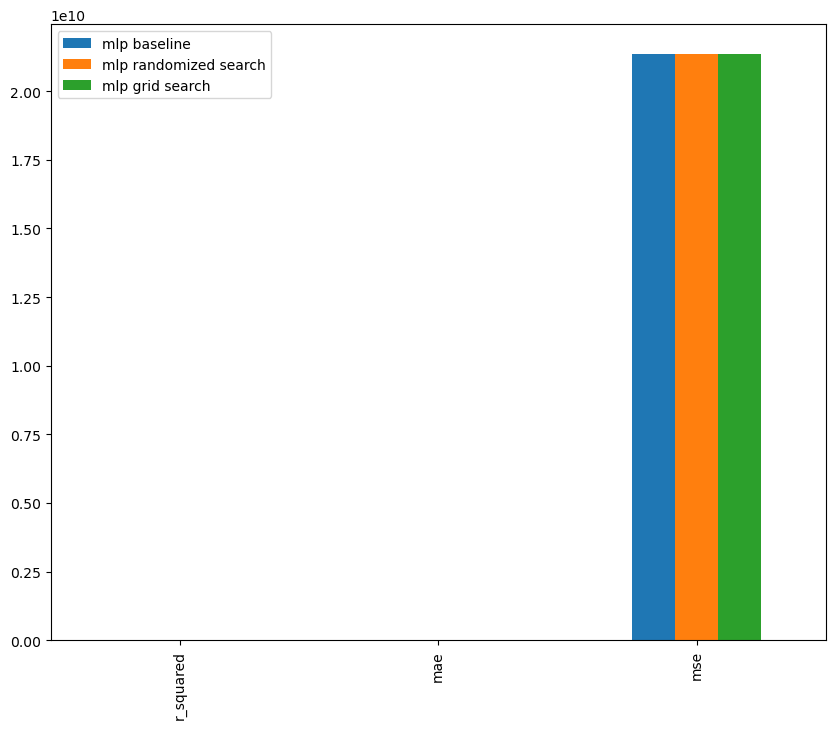

In [106]:
mlp_compare_metrics = pd.DataFrame({
    "mlp baseline": mlp_baseline_metrics,
    "mlp randomized search": mlp_random_metrics,
    "mlp grid search": mlp_metrics
})

mlp_compare_metrics.plot.bar(figsize=(10, 8))

## Conclusion

#### Main Takeaways: 

#### Future Improvements